In [17]:
import sys
sys.path.append('../../')
import datetime as dt
from datetime import date, timedelta
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import importlib
import json
from models.utils import dataloader as u
importlib.reload(u)

<module 'models.utils.dataloader' from '../..\\models\\utils\\dataloader.py'>

In [2]:
demographics = u.load_demographics_data()
demographics

,FIPS,total_pop,60plus,area,median_age,pop_white,pop_black,pop_hispanic,pop_density,p60_plus
0,1001,55036,10523,594.44,37.8,76.9,19.1,2.8,92.584617,0.191202
1,1003,203360,53519,1589.78,42.8,86.3,9.5,4.5,127.917070,0.263174
2,1005,26201,6150,884.88,39.9,47.4,47.6,4.3,29.609665,0.234724
3,1007,22580,4773,622.58,39.9,76.7,22.3,2.4,36.268431,0.211382
4,1009,57667,13600,644.78,40.8,95.5,1.5,9.1,89.436707,0.235837
...,...,...,...,...,...,...,...,...,...,...
3138,56039,22923,4298,3995.38,39.3,90.3,1.2,14.9,5.737377,0.187497
3139,56041,20758,3554,2081.26,35.5,93.4,0.1,9.1,9.973766,0.171211
3140,56043,8253,2206,2238.55,43.5,89.7,0.0,14.2,3.686762,0.267297
3141,56045,7117,2073,2398.09,42.9,92.5,0.5,1.5,2.967779,0.291274


In [2]:
data = u.load_covid_static(days_ago=5)
data

c:\users\kehua\appdata\local\programs\python\python38\lib\site-packages\pandas\core\series.py:856: RuntimeWarning:

divide by zero encountered in log10



,FIPS,County Name,State,cases,deaths,log_cases,log_deaths
0,01001,Autauga County,AL,220,4,2.342423,0.602060
1,01003,Baldwin County,AL,288,9,2.459392,0.954243
2,01005,Barbour County,AL,164,1,2.214844,0.000000
3,01007,Bibb County,AL,75,1,1.875061,0.000000
4,01009,Blount County,AL,62,1,1.792392,0.000000
...,...,...,...,...,...,...,...
3137,56037,Sweetwater County,WY,30,0,1.477121,0.000000
3138,56039,Teton County,WY,100,1,2.000000,0.000000
3139,56041,Uinta County,WY,12,0,1.079181,0.000000
3140,56043,Washakie County,WY,36,3,1.556303,0.477121


In [4]:
cases_per_pop = data['cases'].astype(int) / demographics['total_pop'].astype(int) * 10000
data['cases_per_pop'] = pd.Series(cases_per_pop, index=data.index)
data['logcases_per_pop'] = pd.Series(np.log10(cases_per_pop).replace([np.inf, -np.inf], 0), index=data.index)

data['deaths_per_pop'] = data['deaths'] / demographics['total_pop'] * 100000
data['logdeaths_per_pop'] = pd.Series(np.log10(data['deaths_per_pop'] ).replace([np.inf, -np.inf], 0), index=data.index)

In [5]:
combined = pd.merge(data, demographics)

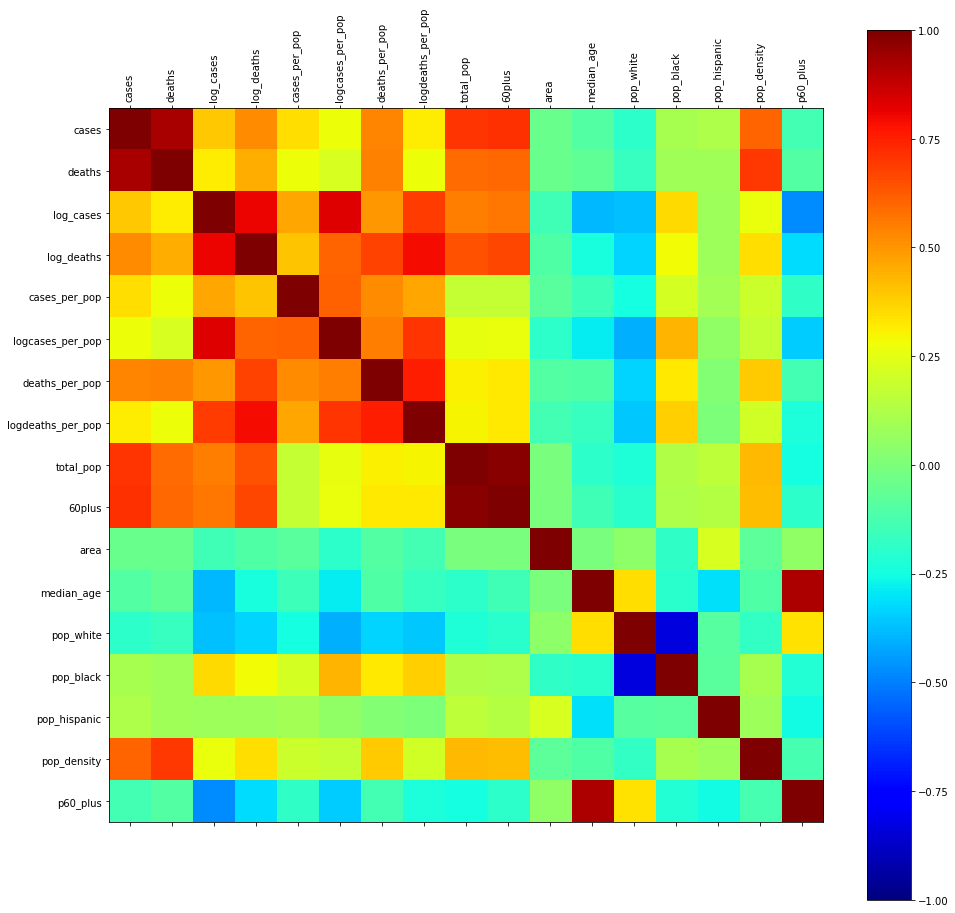

In [6]:
fig = plt.figure(figsize=(16, 16))
ax = fig.add_subplot(111)
a = ax.matshow(combined.corr(), cmap='jet', vmin=-1, vmax=1)
labels = combined.columns.tolist()[2:]
ax.set_xticklabels(labels,rotation=90, fontsize=10)
ax.set_xticks(np.arange(len(labels)))
ax.set_yticklabels(labels, fontsize=10)
ax.set_yticks(np.arange(len(labels)))
fig.colorbar(a)
plt.show()

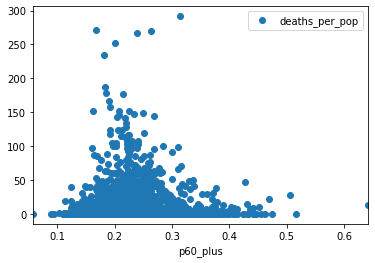

In [25]:
combined.plot(x='p60_plus', y='deaths_per_pop', style='o')
plt.show()

In [10]:
importlib.reload(u)
datadict = u.load_covid_timeseries(smoothing=3, interval_change=1)

In [11]:
data['County Name'][longest[0]]

NameError: name 'longest' is not defined

In [77]:
cases = datadict['cases_raw']
deaths = datadict['deaths_raw']
deaths_calibrated = datadict['deaths_calibrated']
cases_calibrated = datadict['cases_calibrated']
cases_pc = datadict['cases_pc']
deaths_pc = datadict['deaths_pc']
print(deaths_calibrated[longest[3]].astype(int))
print(deaths_pc[longest[3]])

[          0           0           0           0           0          21
          40          60          92         124         149         216
         253         305         376         447         499         590
         685         813         948        1129        1344        1400
        1759        1848        2116        2116        2421        2604
        2754        2754        2754        3114        3221        3329
        3432        3520        3601        3678 -2147483648 -2147483648
 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648
 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648
 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648
 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648
 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648
 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648 -2147483648
 -2147483648 -2147483648 -2147483648 -2147483648 -2

(3143, 114) (3143, 112)


NameError: name 'longest' is not defined

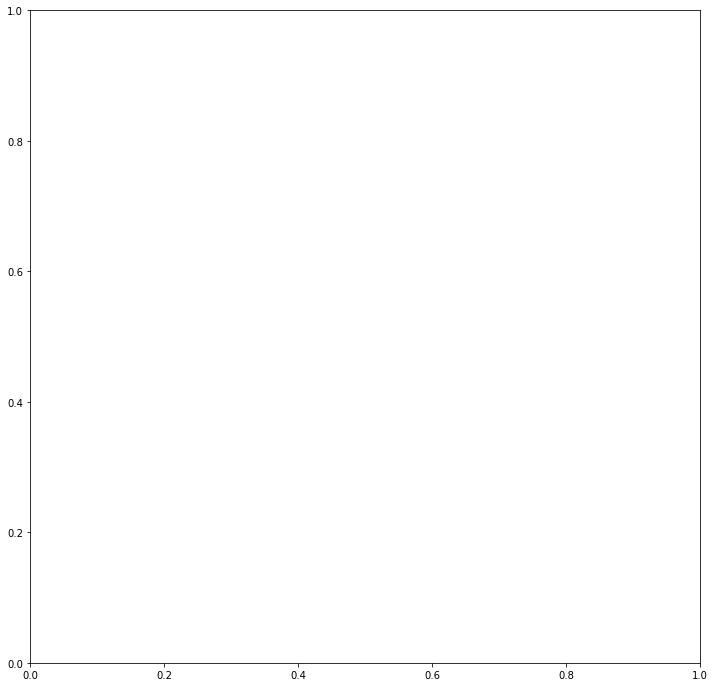

In [22]:
d = datadict['deaths_raw']
d2 = datadict['cases_raw']
d2 = np.diff(d2)
d2 = np.diff(d2)
print(d.shape, d2.shape)
x1 = np.linspace(1, d.shape[1], d.shape[1])
x2 = np.linspace(1, d2.shape[1], d2.shape[1])
fig = plt.figure(figsize=(12, 12))
ax = fig.add_subplot(111)
i = 8
plt.plot(x2, d2[longest[i]].T)#d[longest[i]].T, color='r', label='deaths')
#plt.plot(x2, d2[longest[i]].T, color='b', label='cases')
#plt.legend()
plt.show()

In [202]:
d1 = datadict['cases_pc_smoothed']
d2 = datadict['deaths_pc_smoothed']

s1 = np.sum(~np.isnan(d1), axis=1)
s2 = np.sum(~np.isnan(d2), axis=1)
print(np.argmax(s1), np.argmax(s2))
longest = np.argsort(s1)[-10:][::-1]
print(longest)

2969 2969
[2969 1858 1887 2983 1868 1851 1830 1857  204  610]


In [196]:
d1 = datadict['cases_raw'][:, -1]
longest = np.argsort(d1)[::-1]
print(longest)

[1868 1851 1830 ... 2026 2018 3141]


50


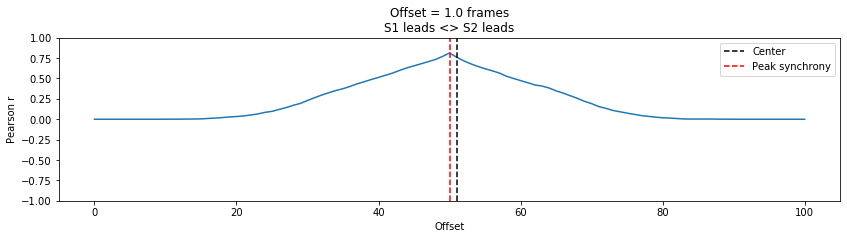

In [122]:
def crosscorr(datax, datay, lag=0, wrap=False):
    """ Lag-N cross correlation. 
    Shifted data filled with NaNs 
    
    Parameters
    ----------
    lag : int, default 0
    datax, datay : pandas.Series objects of equal length
    Returns
    ----------
    crosscorr : float
    """
    if wrap:
        shiftedy = datay.shift(lag)
        shiftedy.iloc[:lag] = datay.iloc[-lag:].values
        return datax.corr(shiftedy)
    else: 
        return datax.corr(datay.shift(lag))
    
size = 50
d1 = datadict['cases_pc_smoothed']
d2 = datadict['deaths_pc_smoothed']
average_rs = np.zeros((2*size + 1,))
average_peaks = []
count = 0
for i in range(d1.shape[0]):
    if np.all(np.isnan(d1[i])):
        continue
    count += 1
    df1 = pd.Series(d1[i]).fillna(0)
    df2 = pd.Series(d2[i]).fillna(0)
    

    rs = np.array([crosscorr(df1,df2, lag) for lag in range(-int(size),int(size + 1))])
    rs1 = np.nan_to_num(rs, 0)
    average_rs += rs1
    center = np.ceil(len(rs)/2)
    rs = np.nan_to_num(rs, -5)
    peak = np.argmax(rs) - center
    average_peaks.append(peak)
average_rs /= count

offset = np.ceil(len(rs)/2)-np.argmax(rs)
f,ax=plt.subplots(figsize=(14,3))
ax.plot(average_rs)
average_rs = np.nan_to_num(average_rs, -5)
ax.axvline(np.ceil(len(average_rs)/2),color='k',linestyle='--',label='Center')
ax.axvline(np.argmax(average_rs),color='r',linestyle='--',label='Peak synchrony')
print(np.argmax(average_rs))
ax.set(title=f'Offset = {offset} frames\nS1 leads <> S2 leads',ylim=[-1,1], xlabel='Offset',ylabel='Pearson r')
plt.legend()

In [127]:
np.mean(average_peaks)

-3.810888252148997

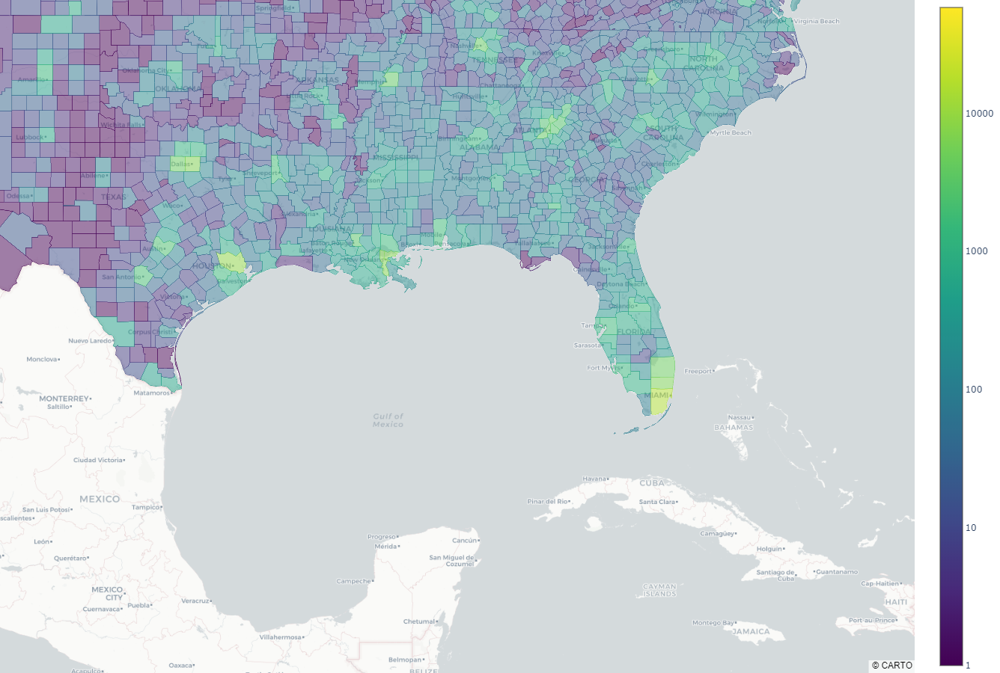

In [26]:
with open('geojson/geojson-counties-fips.json') as f:
    counties = json.load(f)
fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=data['FIPS'], z=data['log_cases'],
                                    colorscale="Viridis", zauto=True, customdata=data['cases'], text=data['County Name'],
                                    hovertemplate='<b>county:%{text}</b><br><b>cases:%{customdata}</b>',
                                    colorbar={'tickvals': [0, 1, 2, 3, 4, 5], 'ticktext': ['1', '10', '100', '1000', '10000', '100000']},
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [139]:
data.head()

,FIPS,County Name,cases,deaths,log_cases,log_deaths,cases_per_pop,logcases_per_pop,deaths_per_pop,logdeaths_per_pop
0,01001,Autauga County,25,1,1.397940,0.0,4.542481,0.657293,1.816993,0.259353
1,01003,Baldwin County,102,0,2.008600,0.0,5.015736,0.700335,0.000000,0.000000
2,01005,Barbour County,14,0,1.146128,0.0,5.343308,0.727810,0.000000,0.000000
3,01007,Bibb County,24,0,1.380211,0.0,10.628875,1.026487,0.000000,0.000000
4,01009,Blount County,18,0,1.255273,0.0,3.121369,0.494345,0.000000,0.000000


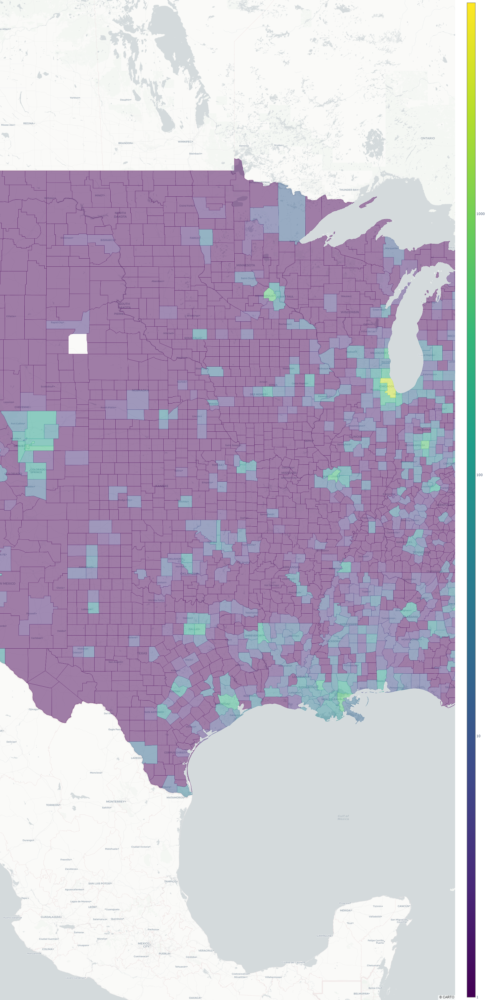

In [12]:
with open('geojson/geojson-counties-fips.json') as f:
    counties = json.load(f)
fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=data['FIPS'], z=data['log_deaths'],
                                    colorscale="Viridis", zauto=True, customdata=data['FIPS'], text=data['County Name'],
                                    hovertemplate='<b>county:%{text}</b><br><b>FIPS:%{customdata}</b><br><b>deaths:%{z}</b>',
                                    colorbar={'tickvals': [0, 1, 2, 3], 'ticktext': ['1', '10', '100', '1000']},
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [3]:
data[data['FIPS'] == '17031']

,FIPS,County Name,State,cases,deaths,log_cases,log_deaths
610,17031,Cook County,IL,77925,3642,4.891677,3.56134


In [4]:
data.iloc[1775]

FIPS                   34003
County Name    Bergen County
State                     NJ
cases                  18272
deaths                  1579
log_cases            4.26179
log_deaths           3.19838
Name: 1775, dtype: object

In [30]:
importlib.reload(u)
d = u.load_international_data()

In [32]:
deaths = np.expand_dims(d, axis=0)
deaths.shape
deaths

array([[    0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            2,     2,     6,    11,    12,    17,    21,    29,    35,
           52,    80,   107,   148,   197,   233,   366,   464,   631,
          827,  1016,  1268,  1441,  1811,  2158,  2505,  2978,  3407,
         4032,  4827,  5476,  6077,  6820,  7505,  8165,  9136, 10023,
        10781, 11591, 12430, 13157, 13917, 14681, 15362, 15889, 16525,
        17129, 17669, 18281, 18851, 19470, 19901, 20465, 21069, 21647,
        22172, 22747, 23227, 23660, 24114, 24648, 25085, 25549, 25969,
        26384, 26644, 26977, 27359, 27682, 27967, 28236, 28710, 28884,
      